In [102]:
import pandas as pd
import seaborn as sns
import os, glob
import matplotlib.pyplot as plt
import numpy as np

In [2]:
# Put all data together

root_data = '../data'
wildcard = '**/*.csv'

files = glob.glob(os.path.join(root_data, wildcard))
files.sort()

# Find unique folder names
folders = [os.path.basename(os.path.dirname(folder)) for folder in files]
folders = np.unique(folders)
folders = [f for f in folders if f not in ["weather", "RawFrequencyData",]]

base_path = os.path.dirname(os.path.dirname(folders[0]))
folders = [os.path.join(root_data, base_path, folder) for folder in folders]
folders

['../data\\Demand',
 '../data\\DemandPred',
 '../data\\Frequency',
 '../data\\Generation',
 '../data\\Wind',
 '../data\\WindPred']

In [3]:
def create_dtm_col(df, date_colname, period_colname, n_per_period=48):
    df[date_colname] = pd.to_datetime(df[date_colname], utc=True)
    df['dtm'] = pd.to_timedelta((df[period_colname] - 1) / n_per_period * 24, unit='H')
    df['dtm'] += df[date_colname]
    return df

def load_all_files_in_folder(folder_path):
    files = glob.glob(os.path.join(folder_path, "*.csv"), recursive=True)
    files.sort()
    return files

def join_all_files_to_csv(file_list):
    df_join = None
    for file in file_list:
        df = pd.read_csv(file)
        if df_join is None:
                df_join = df
        else:
            df_join = pd.concat([df_join, df])
    
    return df_join


# If array inside each key is len(a) == 1, then simply apply pd.to_datetime(val). If len(a) == 2, then apply the create_dtm_col(vals) function
dict_of_transforms = {
    'Demand': ["Datetime"],
    'Generation': ["Datetime"],
    'Wind': ["Datetime"],
    'DemandPred': ['Datetime'],
    'WindPred': ['Datetime'],
    "Frequency": ["Datetime"],
}   


def transform_df_to_datetime(df, dict_of_transforms, folder_name):
    col_keys = dict_of_transforms[folder_name]
    if len(col_keys) == 1:
        df['dtm'] = pd.to_datetime(df[col_keys[0]], utc=True)
    elif len(col_keys) == 2:
        df = create_dtm_col(df, col_keys[0], col_keys[1])
    return df


# Append all csvs together

df_all = None
for folder in folders:
    folder_name = os.path.basename(folder)
    print(folder_name)
    files = load_all_files_in_folder(folder)
    df = join_all_files_to_csv(files)
    #df = transform_df_to_datetime(df, dict_of_transforms, folder_name)
    if df_all is None:
        df_all = df
    else:
        df_all = pd.merge(df_all, df,on='Datetime')
    print(df_all.shape)

#print(df_all.dtypes)
#df_all.head()

Demand
(17520, 21)
DemandPred
(16028, 33)
Frequency
(16028, 44)
Generation


C:\Users\Jordi\AppData\Local\Temp\ipykernel_15800\1594426226.py:56: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Datetime_x'} in the result is deprecated and will raise a MergeError in a future version.
  df_all = pd.merge(df_all, df, on='dtm')


(16028, 81)
Wind


C:\Users\Jordi\AppData\Local\Temp\ipykernel_15800\1594426226.py:56: FutureWarning: Passing 'suffixes' which cause duplicate columns {'_full_text_x', '_count_x', '_id_x'} in the result is deprecated and will raise a MergeError in a future version.
  df_all = pd.merge(df_all, df, on='dtm')


(16028, 78)
WindPred
(16028, 86)


C:\Users\Jordi\AppData\Local\Temp\ipykernel_15800\1594426226.py:56: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Datetime_x'} in the result is deprecated and will raise a MergeError in a future version.
  df_all = pd.merge(df_all, df, on='dtm')


(16028, 100)
Unnamed: 0_x               float64
BRITNED_FLOW                 int64
EAST_WEST_FLOW               int64
ELECLINK_FLOW                int64
EMBEDDED_SOLAR_CAPACITY      int64
                            ...   
_full_text                  object
Settlement_period            int64
Incentive_forecast         float64
Date_y                      object
_id                          int64
Length: 100, dtype: object


,Unnamed: 0_x,BRITNED_FLOW,EAST_WEST_FLOW,ELECLINK_FLOW,EMBEDDED_SOLAR_CAPACITY,EMBEDDED_SOLAR_GENERATION,EMBEDDED_WIND_CAPACITY,EMBEDDED_WIND_GENERATION,ENGLAND_WALES_DEMAND,IFA2_FLOW,...,Datetime_x,Datetime_y,Forecast_Timestamp,_count,Capacity,_full_text,Settlement_period,Incentive_forecast,Date_y,_id
0,NaN,354,0,0,13080,0,6527,2816,18688,-4,...,2021-11-01 00:00:00,2021-11-01 00:00:00,2021-10-31T07:19:46,17520,15477.0,"'-01':3,9 '-10':14 '-11':2,8 '-31':15 '00':5,6...",1,9073.0,2021-11-01,61965
1,NaN,360,0,0,13080,0,6527,2788,18919,11,...,2021-11-01 00:30:00,2021-11-01 00:30:00,2021-10-31T07:19:46,17520,15477.0,"'-01':3,9 '-10':14 '-11':2,8 '-31':15 '00':6 '...",2,9176.0,2021-11-01,61966
2,NaN,109,-13,0,13080,0,6527,2742,18720,134,...,2021-11-01 01:00:00,2021-11-01 01:00:00,2021-10-31T07:19:46,17520,15477.0,"'-01':3,9 '-10':14 '-11':2,8 '-31':15 '00':5,6...",3,9285.0,2021-11-01,61967
3,NaN,103,-112,0,13080,0,6527,2696,18206,137,...,2021-11-01 01:30:00,2021-11-01 01:30:00,2021-10-31T07:19:46,17520,15477.0,"'-01':3,9 '-10':14 '-11':2,8 '-31':15 '00':6 '...",4,9402.0,2021-11-01,61968
4,NaN,-212,-30,0,13080,0,6527,2707,17588,-59,...,2021-11-01 02:00:00,2021-11-01 02:00:00,2021-10-31T07:19:46,17520,15477.0,"'-01':3,9 '-10':14 '-11':2,8 '-31':15 '00':5,6...",5,9525.0,2021-11-01,61969


In [4]:
# Load other 2 datasets

p1 = r"../data\weather\open_meteo_com_interpolated.csv"

df = pd.read_csv(p1)
df['dtm'] = pd.to_datetime(df['dtm'], utc=True)
df_all = pd.merge(df_all, df, on='dtm')
print(df_all.shape)

df_all.head()

(16027, 134)


,Unnamed: 0_x,BRITNED_FLOW,EAST_WEST_FLOW,ELECLINK_FLOW,EMBEDDED_SOLAR_CAPACITY,EMBEDDED_SOLAR_GENERATION,EMBEDDED_WIND_CAPACITY,EMBEDDED_WIND_GENERATION,ENGLAND_WALES_DEMAND,IFA2_FLOW,...,et0_fao_evapotranspiration (mm),vapor_pressure_deficit (kPa),soil_temperature_0_to_7cm (°C),soil_temperature_7_to_28cm (°C),soil_temperature_28_to_100cm (°C),soil_temperature_100_to_255cm (°C),soil_moisture_0_to_7cm (m³/m³),soil_moisture_7_to_28cm (m³/m³),soil_moisture_28_to_100cm (m³/m³),soil_moisture_100_to_255cm (m³/m³)
0,NaN,360,0,0,13080,0,6527,2788,18919,11,...,0.0,0.08,7.7,9.0,11.2,12.9,0.397,0.406,0.408,0.333
1,NaN,109,-13,0,13080,0,6527,2742,18720,134,...,0.0,0.07,7.8,9.0,11.2,12.9,0.398,0.405,0.408,0.334
2,NaN,103,-112,0,13080,0,6527,2696,18206,137,...,0.0,0.07,7.8,9.0,11.2,12.9,0.398,0.405,0.408,0.334
3,NaN,-212,-30,0,13080,0,6527,2707,17588,-59,...,0.0,0.08,8.0,8.9,11.2,12.9,0.404,0.405,0.408,0.334
4,NaN,-231,-58,0,13080,0,6527,2718,17218,-79,...,0.0,0.08,8.0,8.9,11.2,12.9,0.404,0.405,0.408,0.334


In [5]:
# Filter to time span of interest
df_all_range = df_all[(df_all['dtm'] > '2021-11-01') & (df_all['dtm'] < '2022-11-01')]
print(df_all_range.shape)
df_all_range.head()

(16027, 121)


,Datetime,IFA_FLOW,TSD,IFA2_FLOW,EMBEDDED_WIND_GENERATION,ND,MOYLE_FLOW,NEMO_FLOW,ELECLINK_FLOW,PUMP_STORAGE_PUMPING,...,vapor_pressure_deficit (kPa),soil_temperature_0_to_7cm (°C),soil_temperature_7_to_28cm (°C),soil_temperature_28_to_100cm (°C),soil_temperature_100_to_255cm (°C),soil_moisture_0_to_7cm (m³/m³),soil_moisture_7_to_28cm (m³/m³),soil_moisture_28_to_100cm (m³/m³),soil_moisture_100_to_255cm (m³/m³),dtm
0,2021-11-01 00:30:00,16,22799,11,2788,20724,71,573,0,1476,...,0.08,7.7,9.0,11.2,12.9,0.397,0.406,0.408,0.333,2021-11-01 00:30:00
1,2021-11-01 01:00:00,-1,22587,134,2742,20512,100,609,0,1462,...,0.07,7.8,9.0,11.2,12.9,0.398,0.405,0.408,0.334,2021-11-01 01:00:00
2,2021-11-01 01:30:00,5,22132,137,2696,19950,190,610,0,1470,...,0.07,7.8,9.0,11.2,12.9,0.398,0.405,0.408,0.334,2021-11-01 01:30:00
3,2021-11-01 02:00:00,-162,21753,-59,2707,19277,136,543,0,1414,...,0.08,8.0,8.9,11.2,12.9,0.404,0.405,0.408,0.334,2021-11-01 02:00:00
4,2021-11-01 02:30:00,-169,21341,-79,2718,18909,98,537,0,1296,...,0.08,8.0,8.9,11.2,12.9,0.404,0.405,0.408,0.334,2021-11-01 02:30:00


In [6]:
df_all_range.to_csv(os.path.join(root_data, "df_all.csv"), index=False)
df_all_range.to_pickle(os.path.join(root_data, "df_all.pkl"))

## Clean up columns

In [11]:
selected_cols = [
    "dtm",
    "ND",
    "PUMP_STORAGE_PUMPING",
    "Demand_Forecast",
    "Demand_Outturn",
    "Publish_Datetime",
    "0.1",
    "0.2",
    "0.3",
    "0.4",
    "0.5",
    "BIOMASS_perc",
    "CARBON_INTENSITY",
    "FOSSIL_perc",
    "GENERATION",
    "HYDRO_perc",
    "IMPORTS_perc",
    "NUCLEAR_perc",
    "OTHER_perc",
    "SOLAR_perc",
    "STORAGE_perc",
    "WIND_perc",
    "Total",
    "Forecast_Timestamp",
    "Incentive_forecast",
    "temperature_2m (°C)",
    "cloudcover (%)",
    "windspeed_100m (km/h)",
    "winddirection_100m (°)",   
]

cols_names = [
    "datetime",
    "national_demand",
    "pump_demand",
    "demand_forecast",
    "demand_outturn",
    "demand_forecast_publishdate",
    "f01",
    "f02",
    "f03",
    "f04",
    "f05",
    "biomass_perc",
    "carbon_intensity",
    "fossil_perc",
    "generation",
    "hydro_perc",
    "imports_perc",
    "nuclear_perc",
    "other_perc",
    "solar_perc",
    "storage_perc",
    "wind_perc",
    "total_wind_power",
    "wind_forecast_publishdate",
    "wind_forecast",
    "temperature_deg",
    "cloudcover_perc",
    "windspeed_kmh",
    "winddirection_degr",   
]

df_clean = df_all_range[selected_cols]
df_clean.columns = cols_names
df_clean.head()

,datetime,national_demand,pump_demand,demand_forecast,demand_outturn,demand_forecast_publishdate,f01,f02,f03,f04,...,solar_perc,storage_perc,wind_perc,total_wind_power,wind_forecast_publishdate,wind_forecast,temperature_deg,cloudcover_perc,windspeed_kmh,winddirection_degr
0,2021-11-01 00:30:00+00:00,20724,1476,20370,20530,2021-10-31T08:45:00,0.008494,0.000077,0.000027,1.611739e-05,...,0.0,0.0,53.8,10267.074,2021-10-31T07:19:46,9176.0,7.1,73,23.7,222.0
1,2021-11-01 01:00:00+00:00,20512,1462,20150,20743,2021-10-31T08:45:00,0.013711,0.000029,0.000008,5.010766e-06,...,0.0,0.0,54.3,10317.332,2021-10-31T07:19:46,9285.0,7.5,80,24.7,214.0
2,2021-11-01 01:30:00+00:00,19950,1470,19949,20503,2021-10-31T08:45:00,0.010672,0.000016,0.000002,9.573108e-07,...,0.0,0.0,54.0,10091.954,2021-10-31T07:19:46,9402.0,7.5,80,24.7,214.0
3,2021-11-01 02:00:00+00:00,19277,1414,19553,19924,2021-10-31T08:45:00,0.020586,0.000015,0.000002,9.279950e-07,...,0.0,0.0,55.0,10187.366,2021-10-31T07:19:46,9525.0,7.7,100,25.6,215.0
4,2021-11-01 02:30:00+00:00,18909,1296,19123,19261,2021-10-31T08:45:00,0.005257,0.000020,0.000006,2.867731e-06,...,0.0,0.0,55.4,10128.426,2021-10-31T07:19:46,9652.0,7.7,100,25.6,215.0


In [12]:
cols_with_imports = [
 'BRITNED_FLOW',
 'EAST_WEST_FLOW',
 'ELECLINK_FLOW',
 'IFA2_FLOW',
 'IFA_FLOW',
 'MOYLE_FLOW',
 'NEMO_FLOW',
 'NSL_FLOW',

]

df_clean['import_export_electricity'] = df_all_range[cols_with_imports].sum(axis=1)
df_clean.head()

C:\Users\Jordi\AppData\Local\Temp\ipykernel_15800\1620380033.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['import_export_electricity'] = df_all_range[cols_with_imports].sum(axis=1)


,datetime,national_demand,pump_demand,demand_forecast,demand_outturn,demand_forecast_publishdate,f01,f02,f03,f04,...,wind_perc,total_wind_power,wind_forecast_publishdate,wind_forecast,temperature_deg,cloudcover_perc,windspeed_kmh,winddirection_degr,import_export_electricity,import_export_electricity
0,2021-11-01 00:30:00+00:00,20724,1476,20370,20530,2021-10-31T08:45:00,0.008494,0.000077,0.000027,1.611739e-05,...,53.8,10267.074,2021-10-31T07:19:46,9176.0,7.1,73,23.7,222.0,1704,1704
1,2021-11-01 01:00:00+00:00,20512,1462,20150,20743,2021-10-31T08:45:00,0.013711,0.000029,0.000008,5.010766e-06,...,54.3,10317.332,2021-10-31T07:19:46,9285.0,7.5,80,24.7,214.0,1361,1361
2,2021-11-01 01:30:00+00:00,19950,1470,19949,20503,2021-10-31T08:45:00,0.010672,0.000016,0.000002,9.573108e-07,...,54.0,10091.954,2021-10-31T07:19:46,9402.0,7.5,80,24.7,214.0,1306,1306
3,2021-11-01 02:00:00+00:00,19277,1414,19553,19924,2021-10-31T08:45:00,0.020586,0.000015,0.000002,9.279950e-07,...,55.0,10187.366,2021-10-31T07:19:46,9525.0,7.7,100,25.6,215.0,340,340
4,2021-11-01 02:30:00+00:00,18909,1296,19123,19261,2021-10-31T08:45:00,0.005257,0.000020,0.000006,2.867731e-06,...,55.4,10128.426,2021-10-31T07:19:46,9652.0,7.7,100,25.6,215.0,182,182


In [16]:
df_clean['demand_forecast_publishdate'] = pd.to_datetime(df_clean['demand_forecast_publishdate'], utc=True)
df_clean['wind_forecast_publishdate'] = pd.to_datetime(df_clean['wind_forecast_publishdate'], utc=True)

C:\Users\Jordi\AppData\Local\Temp\ipykernel_15800\639853021.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['demand_forecast_publishdate'] = pd.to_datetime(df_clean['demand_forecast_publishdate'], utc=True)
C:\Users\Jordi\AppData\Local\Temp\ipykernel_15800\639853021.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['wind_forecast_publishdate'] = pd.to_datetime(df_clean['wind_forecast_publishdate'], utc=True)


In [17]:
df_clean.dtypes

datetime                       datetime64[ns, UTC]
national_demand                              int64
pump_demand                                  int64
demand_forecast                              int64
demand_forecast_publishdate    datetime64[ns, UTC]
demand_forecast_error                      float64
f01                                        float64
f02                                        float64
f03                                        float64
f04                                        float64
f05                                        float64
biomass_perc                               float64
carbon_intensity                           float64
fossil_perc                                float64
generation                                 float64
hydro_perc                                 float64
imports_perc                               float64
nuclear_perc                               float64
other_perc                                 float64
solar_perc                     

In [18]:
df_clean.to_csv(os.path.join(root_data, "df_clean.csv"), index=False)
df_clean.to_pickle(os.path.join(root_data, "df_clean.pkl"))

# Do some quick data analysis

In [19]:
df = pd.read_pickle(os.path.join(root_data, "df_all.pkl"))
# df['dtm'] = pd.to_datetime(df['dtm'], utc=True) # Already saved in pickle format
df.set_index('dtm')
df.shape, df.dtypes

((16027, 134),
 Unnamed: 0_x                          float64
 BRITNED_FLOW                            int64
 EAST_WEST_FLOW                          int64
 ELECLINK_FLOW                           int64
 EMBEDDED_SOLAR_CAPACITY                 int64
                                        ...   
 soil_temperature_100_to_255cm (°C)    float64
 soil_moisture_0_to_7cm (m³/m³)        float64
 soil_moisture_7_to_28cm (m³/m³)       float64
 soil_moisture_28_to_100cm (m³/m³)     float64
 soil_moisture_100_to_255cm (m³/m³)    float64
 Length: 134, dtype: object)

<AxesSubplot:>

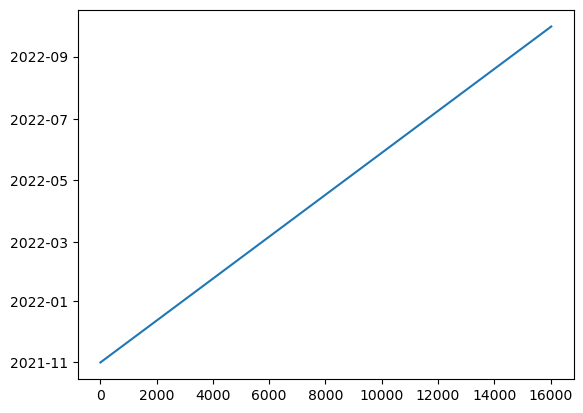

In [20]:
df['dtm'].plot()

In [6]:
desired_cols = [
'IFA_FLOW', 'TSD', 'IFA2_FLOW',
'EMBEDDED_WIND_GENERATION', 'ND', 'MOYLE_FLOW', 'NEMO_FLOW',
'ELECLINK_FLOW', 'PUMP_STORAGE_PUMPING', 'EMBEDDED_WIND_CAPACITY',
'SETTLEMENT_DATE', 'ENGLAND_WALES_DEMAND', 'EMBEDDED_SOLAR_CAPACITY',
'NON_BM_STOR', 'EAST_WEST_FLOW', 'NSL_FLOW', 'BRITNED_FLOW',
'EMBEDDED_SOLAR_GENERATION', 'dtm', 'Total',
'England/Wales Wind Output',
 'Scottish Wind Output', '0.1', '0.2', '0.3',
'0.4', '0.5', 'NUCLEAR',
'STORAGE', 'LOW_CARBON',
'HYDRO', 'IMPORTS', 'GAS', 'CARBON_INTENSITY', 'COAL',
'FOSSIL',
'GENERATION', 'DATETIME', 'OTHER', 'ZERO_CARBON',
'BIOMASS', 'WIND', 'SOLAR',
'RENEWABLE'
]

df_all_c = df_all[desired_cols]
df_all_c.shape

(1488, 44)

In [9]:
sample = df_all_c.sample(n=50)
sns.pairplot(df_all_c)

In [8]:
df_all_c.to_csv("../data/df_all.csv")